In [1]:
import sys
sys.path.append('/fsx/nikitadrobyshev/EMOPortraits')
from networks.volumetric_avatar import FaceParsing
face_idt = FaceParsing(None, 'cuda')

import cv2
import torch
import numpy as np
from torch import nn
from glob import glob
from PIL import Image, ImageOps
from torchvision import transforms
import matplotlib.pyplot as plt
import moviepy.editor as mp
from torchvision import transforms
from dataclasses import dataclass
from torchvision import transforms
from torch.nn import functional as F
from tqdm.notebook import trange, tqdm
from torchvision.transforms import ToTensor, ToPILImage

# sys.path.append('/fsx/nikitadrobyshev/')
from notebooks.infer import InferenceWrapper

# sys.path.append('/fsx/nikitadrobyshev/sound_avatars')
from notebooks.infer_s2 import InferenceWrapper as InferenceWrappers2
from repos.MODNet.src.models.modnet import MODNet

In [2]:
to_tensor = transforms.ToTensor()
to_image = transforms.ToPILImage()
to_flip = transforms.RandomHorizontalFlip(p=1) 
to_512 = lambda x: x.resize((512, 512), Image.ANTIALIAS)
to_256 = lambda x: x.resize((256, 256), Image.ANTIALIAS)

# ========================================================================

## Init main model

In [3]:
project_dir = '/fsx/nikitadrobyshev/EMOPortraits'
args_overwrite = {'l1_vol_rgb':0}

# Choose a model

### (should be more or less equal)

In [4]:
# Retrain_with_17_V1_New_rand_MM_SEC_4_drop_02_stm_10_CV_05_1_1 

In [5]:
inferer = InferenceWrapper(experiment_name = 'Retrain_with_17_V1_New_rand_MM_SEC_4_drop_02_stm_10_CV_05_1_1', model_file_name = '328_model.pth',
                           project_dir = project_dir, folder = 'logs', state_dict = None,
                           args_overwrite=args_overwrite, pose_momentum = 0.1, print_model=False, print_params = True)

None
Hybrid stages [True, True, True]
bbbbbbbbbbb
29110272 6707587
Hybrid stages [True, True, True]
SN applied to local_encoder_nw
SN applied to idt_embedder_nw
SN applied to expression_embedder_nw
SN applied to xy_generator_nw
SN applied to uv_generator_nw
SN applied to warp_embed_head_orig_nw
SN applied to volume_process_nw
SN applied to volume_source_nw
SN applied to decoder_nw
WS applied to local_encoder_nw
WS applied to idt_embedder_nw
WS applied to expression_embedder_nw
WS applied to xy_generator_nw
WS applied to uv_generator_nw
WS applied to warp_embed_head_orig_nw
WS applied to volume_process_nw
WS applied to volume_source_nw
WS applied to decoder_nw
Number of perameters in decoder_nw: 35822211
Number of perameters in expression_embedder_nw: 11506112
Number of perameters in idt_embedder_nw: 24575488
Number of perameters in local_encoder_nw: 10119680
Number of perameters in pose_unsqueeze_nw: 1048576
Number of perameters in uv_generator_nw: 9016451
Number of perameters in volum

## Init superres

In [6]:
inferer_s2 = InferenceWrappers2(project_dir = '/fsx/nikitadrobyshev/EMOPortraits/', experiment_name = 'sota_stage_2', model_file_name = '020_model.pth', pose_momentum = 0.1, cloth=False)

3 512
38289408 3118051
Number of trainable params in local_encoder stage 2 : 5355392
'Model' object has no attribute 'local_encoder_seg'
'Model' object has no attribute 'local_encoder_mask'
'Model' object has no attribute 'idt_embedder'
'Model' object has no attribute 'expression_embedder'
'Model' object has no attribute 'xy_generator'
'Model' object has no attribute 'uv_generator'
'Model' object has no attribute 'warp_embed_head_orig'
'Model' object has no attribute 'volume_process_net'
'Model' object has no attribute 'volume_source_net'
Number of trainable params in decoder stage 2 : 41407459
'Model' object has no attribute 'backgroung_adding'
'Model' object has no attribute 'background_process_net'
Loading model from /fsx/nikitadrobyshev/EmoPortraits/logs_s2/sota_stage_2/checkpoints/020_model.pth


## Init inpainting

In [7]:
lama = torch.jit.load('/fsx/nikitadrobyshev/EMOPortraits/repos/jit_lama.pt').cuda()

In [8]:
def get_modnet_mask(img):
    im_transform = transforms.Compose(
        [
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        ]
    )
    im = im_transform(img)
    ref_size = 512
    im_b, im_c, im_h, im_w = im.shape
    if max(im_h, im_w) < ref_size or min(im_h, im_w) > ref_size:
        if im_w >= im_h:
            im_rh = ref_size
            im_rw = int(im_w / im_h * ref_size)
        elif im_w < im_h:
            im_rw = ref_size
            im_rh = int(im_h / im_w * ref_size)
    else:
        im_rh = im_h
        im_rw = im_w

    im_rw = im_rw - im_rw % 32
    im_rh = im_rh - im_rh % 32
    im = F.interpolate(im, size=(im_rh, im_rw), mode='area')

    # inference
    _, _, matte = modnet(im.cuda(), True)

    # resize and save matteget_mask
    matte = F.interpolate(matte, size=(im_h, im_w), mode='area')

    return matte

@torch.no_grad()
def get_mask(source_img_crop):
    source_img_mask = get_modnet_mask(source_img_crop)
    source_img_mask = source_img_mask
    source_img_mask = source_img_mask.clamp_(max=1, min=0)
    
    return source_img_mask


@torch.no_grad()
def get_mask_fp(source_img_crop):
    face_mask_source, _, _, cloth_s = face_idt.forward(source_img_crop)
    trashhold = 0.6
    face_mask_source = (face_mask_source > trashhold).float()

    source_mask_modnet = get_mask(source_img_crop)

    face_mask_source = (face_mask_source*source_mask_modnet).float()

    return face_mask_source

In [9]:
modnet = MODNet(backbone_pretrained=False)
modnet = nn.DataParallel(modnet).cuda()
modnet.load_state_dict(torch.load('/fsx/nikitadrobyshev/EMOPortraits/repos/MODNet/pretrained/modnet_photographic_portrait_matting.ckpt'))
modnet.eval();

# ========================================================================

# ========================================================================

## Define images

In [56]:
source_img = to_512(Image.open('/fsx/nikitadrobyshev/EMOPortraits/data/IMG_3.png'))
driver_img = to_512(Image.open('/fsx/nikitadrobyshev/EMOPortraits/data/IMG_4.png'))

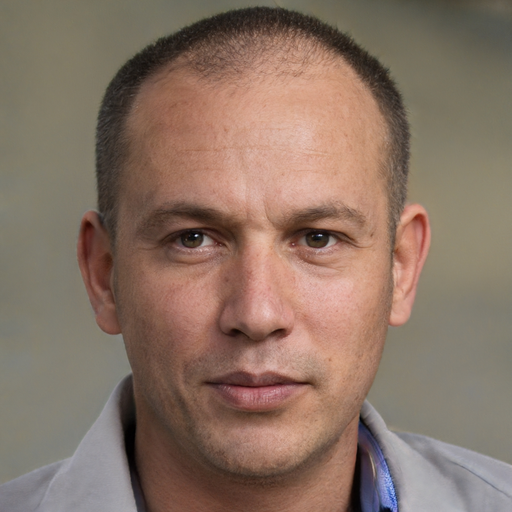

In [57]:
source_img

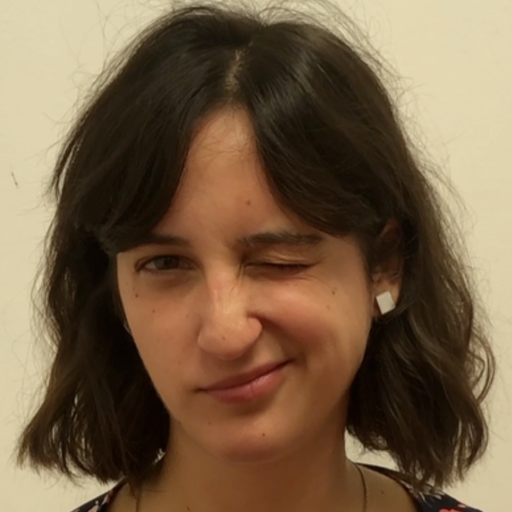

In [58]:
driver_img

# Infer with driver pose

In [59]:
img = inferer.forward(source_img, driver_img, crop=False, smooth_pose=False, target_theta=True, mix=True, mix_old=False, modnet_mask=False)

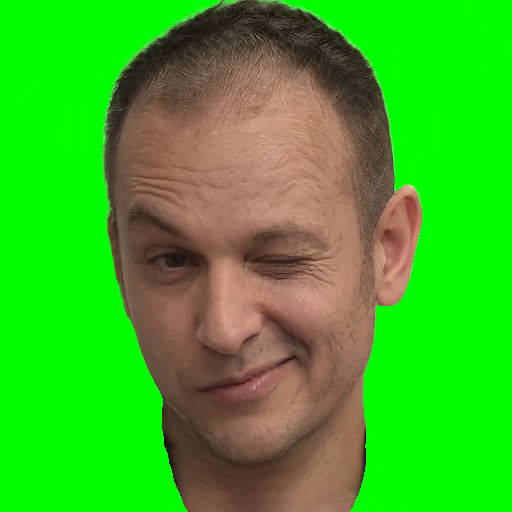

In [60]:
img[0][0]

# Infer with source pose (work generally worse than first option)

In [63]:
img = inferer.forward(source_img, driver_img, crop=False, smooth_pose=False, target_theta=False, mix=True, mix_old=False, modnet_mask=False)

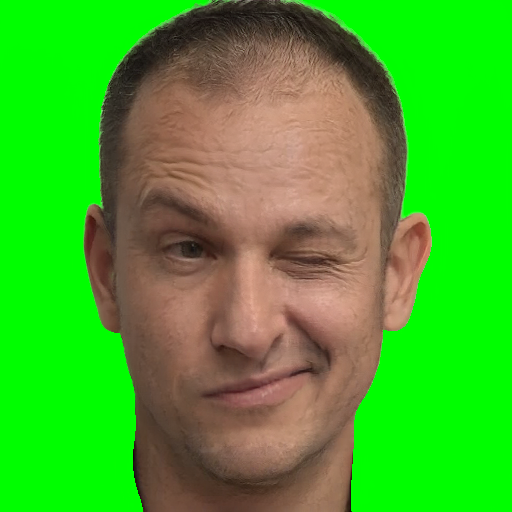

In [64]:
img[0][0]

# Inpainting

In [65]:
gt_img_t = to_tensor(source_img)[:3].unsqueeze(dim=0).cuda()
m = get_mask_fp(gt_img_t)

In [66]:
kernel_back = np.ones((21, 21), 'uint8')
mask = (m >= 0.8).float()
mask = mask[0].permute(1,2,0)
dilate_mask = cv2.dilate(mask.cpu().numpy(), kernel_back, iterations=2)
dilate_mask = torch.FloatTensor(dilate_mask).unsqueeze(0).unsqueeze(0).cuda()
background = lama(gt_img_t.cuda(), dilate_mask.cuda())

In [67]:
bg = to_tensor(to_image(background[0]).resize((512, 512), Image.BICUBIC))

In [68]:
out_frames = []
pred_img_t = to_tensor(img[0][0])[:3].unsqueeze(0).cuda()
_source_img_mask = get_mask_fp(pred_img_t)

In [69]:
mask_sss = torch.where(_source_img_mask>0.3, _source_img_mask, _source_img_mask*0)**8
out_nn = mask_sss.cpu()*pred_img_t.cpu()+ (1-mask_sss.cpu())*bg.cpu()
out_frames.append(to_image(out_nn[0]))

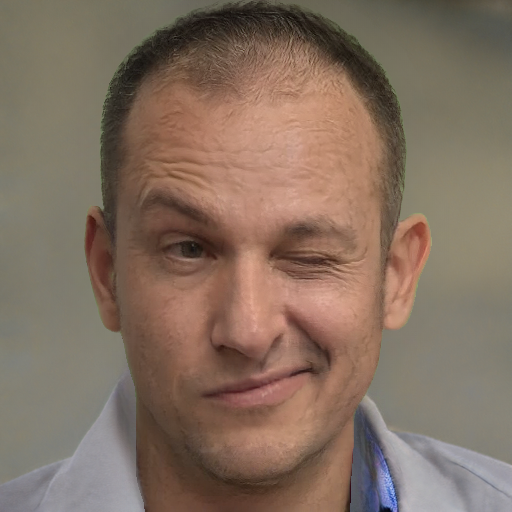

In [70]:
out_frames[0]

# Super-res

In [71]:
img, img_res, img_s2, img_mask = inferer_s2.forward(to_tensor(out_frames[0]).unsqueeze(0).cuda())

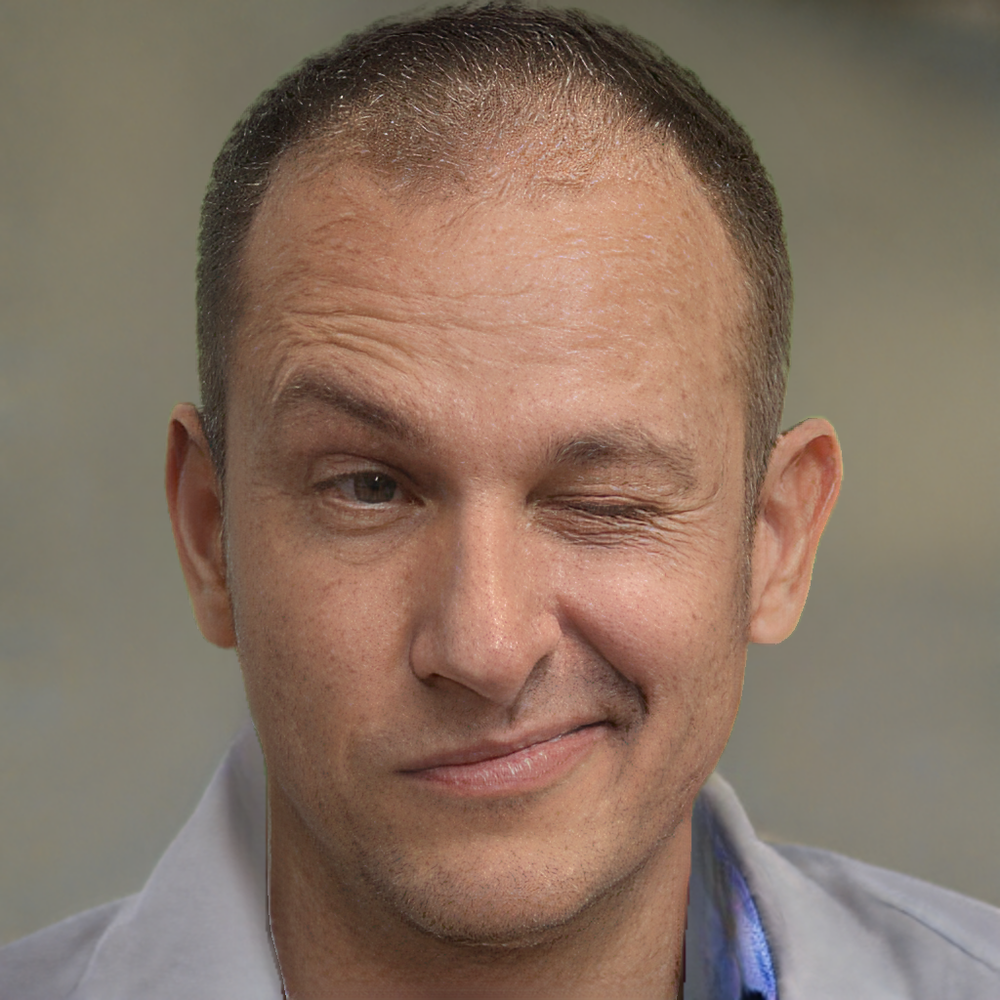

In [72]:
img_s2[0]

## Define functions for video

In [73]:
from ibug.face_detection import RetinaFacePredictor

In [74]:
sort_f = lambda p:  int(p.split('_')[-1])
sort_d = lambda p:  int(p.split('_')[-1][:-4])

In [75]:
def get_bg(s_img, mdnt = True):
    gt_img_t = to_tensor(s_img)[:3].unsqueeze(dim=0).cuda()
    m = get_mask(gt_img_t) if mdnt else get_mask_fp(gt_img_t)
    kernel_back = np.ones((21, 21), 'uint8')
    mask = (m >= 0.8).float()
    mask = mask[0].permute(1,2,0)
    dilate_mask = cv2.dilate(mask.cpu().numpy(), kernel_back, iterations=2)
    dilate_mask = torch.FloatTensor(dilate_mask).unsqueeze(0).unsqueeze(0).cuda()
    background = lama(gt_img_t.cuda(), dilate_mask.cuda())
    bg_img = to_image(background[0])
    bg = to_tensor(bg_img.resize((512, 512), Image.BICUBIC))
    return bg, bg_img

In [76]:
def connect_img_and_bg(img, bg, mdnt=True):
    pred_img_t = to_tensor(img)[:3].unsqueeze(0).cuda()
    _source_img_mask = get_modnet_mask(pred_img_t) if mdnt else get_mask_fp(pred_img_t)
    mask_sss = torch.where(_source_img_mask>0.3, _source_img_mask, _source_img_mask*0)**8
    out_nn = mask_sss.cpu()*pred_img_t.cpu()+ (1-mask_sss.cpu())*bg.cpu()
    return to_image(out_nn[0])

In [77]:
def do_stage_2(input_img):
    img, img_res, img_s2, img_mask = inferer_s2.forward(to_tensor(input_img).unsqueeze(0).cuda())
    return img_s2[0]

In [78]:
threshold = 0.8
device = 'cuda'

In [79]:
face_detector = RetinaFacePredictor(threshold=threshold, device=device, model=(RetinaFacePredictor.get_model('mobilenet0.25')))

In [80]:
def get_custom_crop(img, k=1.2, in_s=512):
    mpl = in_s//512
    img_cv2 =  np.asarray(img)*255
    _faces = face_detector(img_cv2, rgb=False)
    if _faces.shape[0]==0:
        return to_512(img.crop((64*mpl, 64*mpl, 448*mpl, 448*mpl)))
    else:
        faces = _faces[0]
        center = (int(faces[0] + (faces[2]-faces[0])/2), int(faces[1]+ (faces[3]-faces[1])/2))
        size = max(int((faces[2]-faces[0])/2), int((faces[3]-faces[1])/2))
        new_img = to_512(img.crop((center[0]-size*k, center[1]-size*k, center[0]+size*k, center[1]+size*k)))
        return new_img

In [81]:
def get_custom_crop_first(img, k=1.2, in_s=512, first_frame=True, center=None, size=None):
    mpl = in_s//512
    img_cv2 =  np.asarray(img)*255
    if first_frame:
        _faces = face_detector(img_cv2, rgb=False)
        if _faces.shape[0]==0:
            raise ValueError('Face not found')
        else:
            faces = _faces[0]
            center = (int(faces[0] + (faces[2]-faces[0])/2), int(faces[1]+ (faces[3]-faces[1])/2))
            size = max(int((faces[2]-faces[0])/2), int((faces[3]-faces[1])/2))
            new_img = to_512(img.crop((center[0]-size*k, center[1]-size*k, center[0]+size*k, center[1]+size*k)))
            return new_img, center, size
    else:
        new_img = to_512(img.crop((center[0]-size*k, center[1]-size*k, center[0]+size*k, center[1]+size*k)))
        return new_img

In [82]:
def get_video_frames_as_images(video_path):
    cap = cv2.VideoCapture(video_path)
    frames = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        # Конвертация из BGR в RGB
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        img = to_512(Image.fromarray(frame_rgb))
        frames.append(img)

    cap.release()
    return frames

In [83]:
def make_video(source, drivers, out_frames_b, path, fps=30.0):
    videodims = (3*512, 512)
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    video = cv2.VideoWriter(path, fourcc, fps, videodims)
    #draw stuff that goes on every frame here
    for i in tqdm(range(0,len(out_frames_b))):
        our_s2 = out_frames_b[i]
        out_img = np.array(np.concatenate([np.array(source.resize((512, 512), Image.ANTIALIAS))[:, :, :3], np.array(drivers[i].resize((512, 512), Image.ANTIALIAS)), np.array(our_s2.resize((512, 512), Image.ANTIALIAS))], axis=1))
        video.write(cv2.cvtColor(out_img, cv2.COLOR_RGB2BGR))
    video.release()

In [84]:
def make_video_crop(source, drivers, out_frames_b, path, fps=30.0, k=2, size=128):
    videodims = (3*512, 512)
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    video = cv2.VideoWriter(path, fourcc, fps, videodims)
    #draw stuff that goes on every frame here
    for i in tqdm(range(0,len(out_frames_b))):
        our_s2 = out_frames_b[i]
        out_img = np.array(np.concatenate([np.array(source.resize((512, 512), Image.ANTIALIAS))[:, :, :3], np.array(to_512(to_512(drivers[i]).crop((256-size*k, 256-size*k, 256+size*k, 256+size*k))) ), np.array(to_512(to_512(our_s2).crop((256-size*k, 256-size*k, 256+size*k, 256+size*k)))    )], axis=1))
        video.write(cv2.cvtColor(out_img, cv2.COLOR_RGB2BGR))
    video.release()

## Main function

In [85]:
def drive_image_with_video(source, video_path = '/fsx/nikitadrobyshev/gigaportraits/data/demo/demo_3.mp4', get_crop = True, crop_rate=1.3, max_len=None):

    all_srs = []
    all_bgs = []
    all_img_bg = []
    all_stage_2 = []
    all_stage_2_crop = []

    all_curr_d = get_video_frames_as_images(video_path)
    all_curr_d = all_curr_d[:max_len]
    first_d = all_curr_d[0]
    img = inferer.forward(source, first_d, crop=False, smooth_pose=False, target_theta=True, mix=True, mix_old=False, modnet_mask=False)
    all_srs.append(source)
    
    
    #make background 
    bg, bg_img = get_bg(source, mdnt=False)
    all_bgs.append(bg_img)
    
    # infer
    img_with_bg = connect_img_and_bg(img[0][0], bg, mdnt=False)
    sr_img_with_bg = to_512(do_stage_2(img_with_bg))
    all_img_bg.append(img_with_bg)
    all_stage_2.append(sr_img_with_bg)
    
    #cropped
    if get_crop:
        sr_img_with_bg_crop, center, size = get_custom_crop_first(sr_img_with_bg, k=crop_rate, first_frame=True)
        all_stage_2_crop.append(sr_img_with_bg_crop)
    
    
    for curr_d in tqdm(all_curr_d[1:]):
        img = inferer.forward(None, curr_d, crop=False, smooth_pose=False, target_theta=True, mix=True, mix_old=False, modnet_mask=False)
        img_with_bg = connect_img_and_bg(img[0][0], bg, mdnt=False)
        sr_img_with_bg = do_stage_2(img_with_bg)
        all_img_bg.append(img_with_bg)
        all_stage_2.append(sr_img_with_bg)
    
        sr_img_with_bg_crop = get_custom_crop_first(sr_img_with_bg, first_frame=False, center = center, size = size)
        all_stage_2_crop.append(sr_img_with_bg_crop)
    
    return all_stage_2, None if not get_crop else all_stage_2_crop, all_curr_d
        
        

# Define source image and driving video

In [50]:
source_img = to_512(Image.open('/fsx/nikitadrobyshev/EMOPortraits/data/IMG_1.png'))
driving_video_path = '/fsx/nikitadrobyshev/EMOPortraits/data/VID_1.mp4'

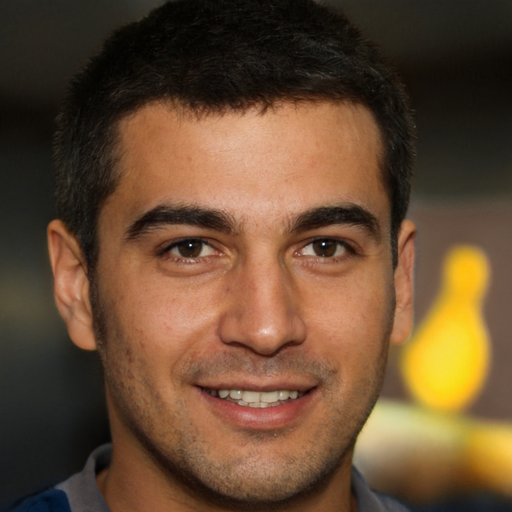

In [51]:
source_img 

In [52]:
imgs, crop_imgs, drivers = drive_image_with_video(source_img, driving_video_path)

  0%|          | 0/988 [00:00<?, ?it/s]

# Save as a video

In [53]:
save_path = '/fsx/nikitadrobyshev/EMOPortraits/data/IMG_1_VID_1.mp4'

In [54]:
make_video_crop(source_img, imgs, drivers, save_path, fps=60.0)

  0%|          | 0/989 [00:00<?, ?it/s]

# Show video

In [55]:
mp.VideoFileClip(save_path).ipython_display()

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## Example 2

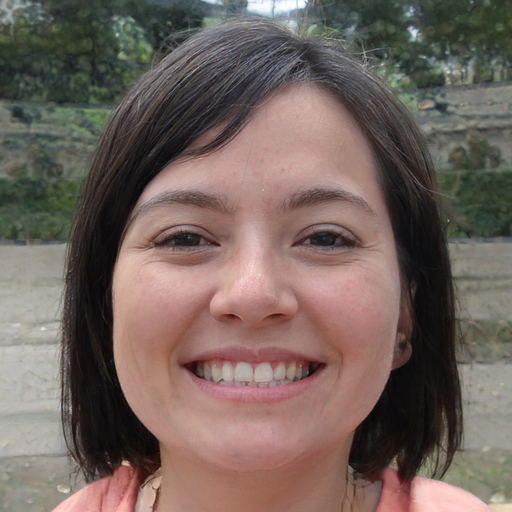

In [160]:
source_img = to_512(Image.open('/fsx/nikitadrobyshev/EMOPortraits/data/IMG_2.png'))
driving_video_path = '/fsx/nikitadrobyshev/EMOPortraits/data/VID_2.mp4'
source_img

In [161]:
imgs, crop_imgs, drivers = drive_image_with_video(source_img, driving_video_path, max_len = 600)

  0%|          | 0/599 [00:00<?, ?it/s]

In [162]:
save_path = '/fsx/nikitadrobyshev/EMOPortraits/data/ING_2_VID_2.mp4'

In [163]:
make_video_crop(source_img, imgs, drivers, save_path, fps=30.0)

  0%|          | 0/600 [00:00<?, ?it/s]

In [164]:
mp.VideoFileClip(save_path).ipython_display(maxduration=60000)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4
